# TODO

If I want to use the overlap background of shared genes with any associations (i.e. 9000), then I should also filter to the input genes that are shared right??
Maybe I should just use the 20k for now.

# SetUp

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from collections import defaultdict
from tqdm import tqdm
import networkx as nx
from matplotlib_venn import venn2, venn3
import obonet as obo

In [6]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams.update({'font.size': 12})
plt.rcParams['axes.linewidth'] = 0.5
plt.rcParams['hatch.linewidth'] = 0.5
plt.rcParams['xtick.major.width'] = 0.4
plt.rcParams['ytick.major.width'] = 0.4
plt.rcParams['xtick.minor.width'] = 0.3
plt.rcParams['ytick.minor.width'] = 0.3
plt.rcParams['legend.frameon'] = False
plt.rcParams['xtick.major.size'] = 3
plt.rcParams['ytick.major.size'] = 3
plt.rcParams['xtick.minor.size'] = 2
plt.rcParams['ytick.minor.size'] = 2
plt.rcParams['xtick.major.pad'] = 1
plt.rcParams['ytick.major.pad'] = 1
plt.rcParams['axes.labelpad'] = 1
plt.rcParams['patch.linewidth'] = 0.25

In [7]:
datadir='/cellar/users/snwright/Data/RareCommon/'
outdir='/cellar/users/snwright/Data/Transfer/RVC/'
figdir='/cellar/users/snwright/Data/Transfer/RVC/figures/Figure_Inputs/'

## Load data

In [8]:
pcnet2_nodes = pd.read_csv(os.path.join(datadir, 'inputs', 'pcnet2_0_nodes.txt'), sep='\t', header=None, names=['Entrez', 'degree'])
all_nodes = pcnet2_nodes.Entrez.unique()

In [9]:
rv_gda = pd.read_csv(os.path.join(datadir,'RAVAR' ,'gene_fulltable_06112024.txt.entrez'), sep='\t')
cv_gda = pd.read_csv(os.path.join(datadir, 'GWASCatalog', 'gwas_catalog_Jan29_2025.txt.cleanedJan29.entrez'), sep="\t")
cv_study_info = pd.read_csv(os.path.join(datadir, 'GWASCatalog','trait_info_cleaned_Jan29_2025.txt'), sep='\t')

In [10]:
#cv_gda = cv_gda.drop(columns=['TRAIT_CODE', 'MAPPED_TRAIT_URI']).merge(cv_study_info.drop(columns=['COHORT', 'ASSOCIATION COUNT', 'SUMMARY STATS LOCATION' ]), on=['STUDY ACCESSION', "DISEASE/TRAIT"])
cv_gda['TRAIT_CODE'] = cv_gda.TRAIT_CODE.apply(lambda x: x.replace(':', "_"))
studies_with_background = cv_study_info[~cv_study_info['MAPPED BACKGROUND TRAIT URI'].isna()]['STUDY ACCESSION'].values
cv_gda = cv_gda[~cv_gda['STUDY ACCESSION'].isin(studies_with_background)]

In [11]:
rv_gda = rv_gda[rv_gda.Entrez.isin(all_nodes)]
cv_gda = cv_gda[cv_gda.Entrez.isin(all_nodes)]

# Figures
## RAVAR / GWAS Catalog Overlap

In [18]:
cv_traits = cv_gda.TRAIT_CODE.unique()
rv_traits = rv_gda.TRAIT_CODE.unique()

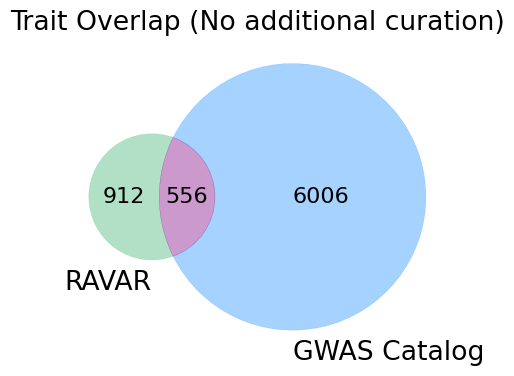

In [19]:
plt.rcParams.update({'font.size': 16})
_ = plt.figure(figsize=(5,5))

v = venn2([set(rv_traits), set(cv_traits)], set_labels=('RAVAR', 'GWAS Catalog'))
v.get_patch_by_id('10').set_color('mediumseagreen')
v.get_patch_by_id('01').set_color('dodgerblue')
v.get_patch_by_id('11').set_color('purple')
plt.title('Trait Overlap (No additional curation)')
plt.savefig(os.path.join(figdir, 'trait_overlap_venn2.png'), dpi=400, bbox_inches='tight')
plt.rcParams.update({'font.size': 12})

## RAVAR / GWAS Catalog Overlap after filtering

### No study filtering

In [20]:
cv_gda_counts = cv_gda.groupby('TRAIT_CODE').Entrez.nunique().reset_index()
rv_gda_counts = rv_gda.groupby('TRAIT_CODE').Entrez.nunique().reset_index()

In [21]:
threshold_counts = {}
for i in [1,2,3,4,5,10,25]:
    threshold_counts[i] = len(set(cv_gda_counts[cv_gda_counts.Entrez >= i].TRAIT_CODE.values).intersection(rv_gda_counts[rv_gda_counts.Entrez >= i].TRAIT_CODE.values))

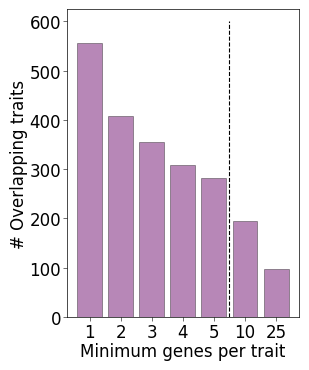

In [34]:
_ = plt.figure(figsize=(3,4))
sns.barplot(threshold_counts, color='purple', alpha=0.5, edgecolor='black', linewidth=0.5)
plt.xlabel('Minimum genes per trait')
plt.ylabel('# Overlapping traits')
plt.vlines(x=4.5, ymin=0, ymax=600, color='black', linestyle='dashed', linewidth=0.8)
plt.ylim(0, 625)
plt.savefig(os.path.join(figdir, 'overlapping_trait_bar.png'), dpi=400, bbox_inches='tight')

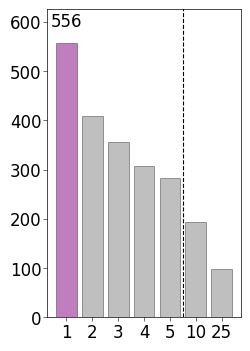

In [35]:
_ = plt.figure(figsize=(2.5,4))
sns.barplot(pd.DataFrame({'y':threshold_counts}).reset_index(),x='index', y='y', hue='index', palette=['purple'] + ['grey'] *6  , 
            alpha=0.5, edgecolor='black', linewidth=0.5, saturation=1, legend=False)
plt.xlabel('')
plt.ylabel('')
plt.text(x=0, y=590, s=f'{threshold_counts[1]}', ha='center')
plt.vlines(x=4.5, ymin=0, ymax=650, color='black', linestyle='dashed', linewidth=0.8)
plt.ylim(0, 625)
plt.savefig(os.path.join(figdir, 'overlapping_trait_bar_highlight1.png'), dpi=400, bbox_inches='tight')

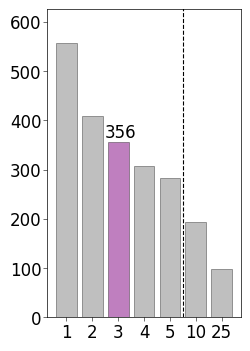

In [36]:
_ = plt.figure(figsize=(2.5,4))
sns.barplot(pd.DataFrame({'y':threshold_counts}).reset_index(),x='index', y='y', hue='index', palette=['grey'] *2 + ['purple'] + ['grey']*4, 
            alpha=0.5, edgecolor='black', linewidth=0.5, saturation=1, legend=False)
plt.xlabel('')
plt.ylabel('')
plt.text(x=2.1, y=365, s=f'{threshold_counts[3]}', ha='center')
plt.vlines(x=4.5, ymin=0, ymax=650, color='black', linestyle='dashed', linewidth=0.8)
plt.ylim(0, 625)
plt.savefig(os.path.join(figdir, 'overlapping_trait_bar_highlight3.png'), dpi=400, bbox_inches='tight')

### With study filtering

In [37]:
cv_gda['StudyTrait'] = cv_gda['STUDY ACCESSION'] + cv_gda['TRAIT_CODE']
rv_gda['StudyTrait'] = rv_gda['PMID'].astype(str) + rv_gda['TRAIT_CODE']

In [38]:
keep_cv_studies = cv_gda.groupby(['StudyTrait']).Entrez.nunique().reset_index()
keep_cv_studies = keep_cv_studies[keep_cv_studies.Entrez>=3]['StudyTrait'].values

In [39]:
keep_rv_studies = rv_gda.groupby(['StudyTrait']).Entrez.nunique().reset_index()
keep_rv_studies = keep_rv_studies[keep_rv_studies.Entrez>=3]['StudyTrait'].values

In [40]:
cv_traits = cv_gda[cv_gda['StudyTrait'].isin(keep_cv_studies)].TRAIT_CODE.unique()
rv_traits = rv_gda[rv_gda['StudyTrait'].isin(keep_rv_studies)].TRAIT_CODE.unique()

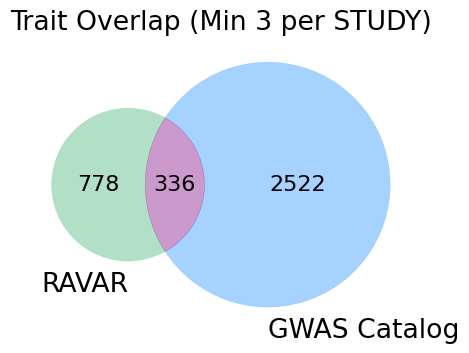

In [103]:
plt.rcParams.update({'font.size': 16})
_ = plt.figure(figsize=(5,5))
v = venn2([set(rv_traits), set(cv_traits)], set_labels=('RAVAR', 'GWAS Catalog'))
v.get_patch_by_id('10').set_color('mediumseagreen')
v.get_patch_by_id('01').set_color('dodgerblue')
v.get_patch_by_id('11').set_color('purple')
plt.title('Trait Overlap (Min 3 per STUDY)')
plt.savefig(os.path.join(figdir, 'trait_overlap_venn2_min3.png'), dpi=400, bbox_inches='tight')
plt.savefig(os.path.join(figdir, 'trait_overlap_venn2_min3.svg'), dpi=400, bbox_inches='tight')

In [42]:
cv_gda_counts = cv_gda.groupby(['StudyTrait', 'TRAIT_CODE']).Entrez.nunique().reset_index()
rv_gda_counts = rv_gda.groupby(['StudyTrait', 'TRAIT_CODE']).Entrez.nunique().reset_index()
threshold_counts = {}
for i in [1,2,3,4,5,6,7,8,9,10, 25, 50, 100]:
    
    threshold_counts[i] = len(set(cv_gda_counts[cv_gda_counts.Entrez >= i].TRAIT_CODE.values).intersection(set(rv_gda_counts[rv_gda_counts.Entrez >= i].TRAIT_CODE.values)))

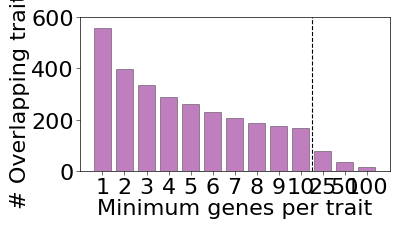

In [43]:
_ = plt.figure(figsize=(4,2))
sns.barplot(threshold_counts, color='purple', alpha=0.5, edgecolor='black', linewidth=0.5, saturation=1)
plt.xlabel('Minimum genes per trait')
plt.ylabel('# Overlapping traits')
plt.vlines(x=9.5, ymin=0, ymax=600, color='black', linestyle='dashed', linewidth=0.8)
plt.ylim(0, 600)
plt.savefig(os.path.join(figdir, 'overlapping_trait_bar_min3.png'), dpi=400, bbox_inches='tight')

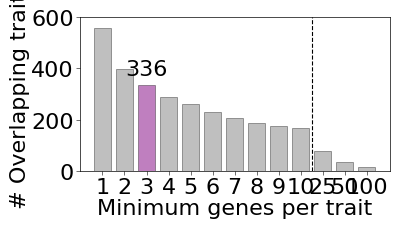

In [44]:
_ = plt.figure(figsize=(4,2))
sns.barplot(pd.DataFrame({'y':threshold_counts}).reset_index(),x='index', y='y', hue='index', palette=['grey'] *2 + ['purple'] + ['grey']*10, 
            alpha=0.5, edgecolor='black', linewidth=0.5, saturation=1, legend=False)
plt.xlabel('Minimum genes per trait')
plt.ylabel('# Overlapping traits')
plt.text(x=2, y=375, s=f'{threshold_counts[3]}', ha='center')
plt.vlines(x=9.5, ymin=0, ymax=600, color='black', linestyle='dashed', linewidth=0.8)
plt.ylim(0, 600)
plt.savefig(os.path.join(figdir, 'overlapping_trait_bar_highlight3_min3.png'), dpi=400, bbox_inches='tight')

## Establish overlapping traits

In [45]:
final_cv_gda = cv_gda[cv_gda.StudyTrait.isin(cv_gda_counts[cv_gda_counts.Entrez >= 3].StudyTrait.values)]
final_rv_gda = rv_gda[rv_gda.StudyTrait.isin(rv_gda_counts[rv_gda_counts.Entrez >= 3].StudyTrait.values)]
overlap_traits = set(final_cv_gda.TRAIT_CODE.unique()).intersection(set(final_rv_gda.TRAIT_CODE.unique()))
final_cv_gda = final_cv_gda[final_cv_gda.TRAIT_CODE.isin(overlap_traits)]
final_rv_gda = final_rv_gda[final_rv_gda.TRAIT_CODE.isin(overlap_traits)]

## Disease distribution of traits

In [105]:
efo = obo.read_obo('http://www.ebi.ac.uk/efo/efo.obo')
efo_root='EFO:0000001'
n = list(efo.nodes())
depths = nx.single_target_shortest_path_length(efo, efo_root)
depth_dict = {source:distance for source, distance in depths}

In [125]:
efo = obo.read_obo('http://www.ebi.ac.uk/efo/efo.obo')
efo_root='EFO:0000001'
all_efo = ['_'.join(x.split('_')[1:3]) for x in pairs]


['EFO_0009322',
 'EFO_0007997',
 'EFO_0009959',
 'EFO_0009819',
 'EFO_0010114',
 'EFO_0010116',
 'EFO_0009767',
 'EFO_0010117',
 'EFO_0009765',
 'EFO_0007992',
 'EFO_0010119',
 'EFO_0010226',
 'EFO_0010451',
 'EFO_0008205',
 'EFO_0009189',
 'EFO_0008317',
 'EFO_0009759',
 'EFO_0008406',
 'EFO_0008561',
 'EFO_0008582',
 'EFO_0008591',
 'EFO_0010732',
 'EFO_0010476',
 'EFO_0009961',
 'EFO_0009458',
 'EFO_0009130',
 'EFO_0009454',
 'EFO_0010066',
 'EFO_0000095',
 'EFO_0010815',
 'MONDO_0002253',
 'MONDO_0002009',
 'MONDO_0001823',
 'MONDO_0001627',
 'HP_0100790',
 'HP_0012532',
 'HP_0012115',
 'HP_0003418',
 'HP_0002619',
 'HP_0002321',
 'HP_0002315',
 'HP_0002140',
 'HP_0002015',
 'HP_0001634',
 'HP_0001537',
 'HP_0001082',
 'MONDO_0002108',
 'MONDO_0002974',
 'HP_0000545',
 'MONDO_0004247',
 'MONDO_0021108',
 'MONDO_0019338',
 'MONDO_0018364',
 'MONDO_0018309',
 'MONDO_0018076',
 'MONDO_0017276',
 'MONDO_0016581',
 'MONDO_0007915',
 'MONDO_0005277',
 'MONDO_0005178',
 'MONDO_0005129',
 

In [122]:
efo.nodes['BAO_0000875']['name']

'Cyclic adenosine monophosphate'

NodeDataView({'BAO_0000875': {'name': 'Cyclic adenosine monophosphate', 'is_a': ['CHEBI:24431']}, 'BAO_0000925': {'name': 'Glucose-6-phosphate', 'is_a': ['CHEBI:24431']}, 'BFO:0000015': {'name': 'process', 'alt_id': ['http://www.ifomis.org/bfo/1.1/span#ProcessualEntity'], 'def': '"A process is an entity that exists in time by occurring or happening, has temporal parts and always involves and depends on some entity during the time it occurs." []', 'xref': ['NCIt:C29862', 'SNOMEDCT:415178003'], 'is_a': ['EFO:0000001'], 'property_value': ['EFO:URI "http://www.ebi.ac.uk/efo/EFO_0001433" xsd:string', 'IAO:0000117 "James Malone" xsd:string', 'organizational:class "true" xsd:string', 'source:definition "An occurrent [span:Occurrent] that exists in time by occurring or happening, has temporal parts and always involves and depends on some entity." xsd:string']}, 'BFO:0000016': {'name': 'disposition', 'alt_id': ['http://www.ifomis.org/bfo/1.1/snap#Disposition'], 'def': '"A disposition is an enti

In [107]:
def collect_ancestor_counts(trait_set, efo):
    efo_counts = defaultdict(int)
    failed_traits = []
    for trait in list(trait_set):
        trait = trait.replace('_', ':')
        if trait in efo.nodes:
            for ancestor in list(nx.descendants(efo, trait)):
                efo_counts[ancestor] += 1
        else:
            failed_traits.append(trait)
    return efo_counts, failed_traits

def parent_counts_min_genes(overlap_counts, efo, thresholds=[1,3,5,10]):
    counts = []
    for th in thresholds:
        traits = overlap_counts[overlap_counts['Min Genes'] >= th].index.values
        efo_counts, failed_traits = collect_ancestor_counts(traits, efo)
        counts.append(efo_counts)
    counts_df = pd.DataFrame({th:efo_counts for th, efo_counts in zip(thresholds, counts)})
    return counts_df

def assign_trait_to_global(trait, efo, high_level_terms=['EFO:0000408','EFO:0001444','HP:0000118']):
    trait = trait.replace('_', ':')
    high_level_parents = []
    if trait in efo.nodes:
        for ancestor in list(nx.descendants(efo, trait)):
            if ancestor in high_level_terms:
                high_level_parents.append(ancestor)
    else:
        print(trait)
    return high_level_parents

def assign_trait_list_to_global(trait_list, efo, high_level_terms=['EFO:0000408','EFO:0001444','HP:0000118']):
    groups = {trait:[] for trait in high_level_terms}
    for trait in trait_list:
        parents = assign_trait_to_global(trait ,efo, high_level_terms=high_level_terms)
        try:
            for term in parents:
                groups[term].append(trait)
        except:
            print(parents)
    return groups

In [108]:
replace_efo_terms = {'EFO_0004526':'OBA:0003460',
'EFO_0005409': 'OBA:0004528',
'EFO_0005208':'OBA:0003747',
'EFO_0008317':'OBA:VT0005144',
'EFO_0005055': 'OBA:1001086',
'EFO_0004465': 'OBA:VT0000188',
'EFO_0004505':'OBA:0003784',
'EFO_0008582': 'OBA:2050320',
'EFO_0004342':'OBA:1001085',
'EFO_0004766': 'OBA:1000023',
'EFO_0004535': 'OBA:2050068',
'EFO_0004339': 'OBA:VT0001253',
'EFO_0007822': 'OBA:0002313',
'EFO_0004584': 'OBA:0003277',
'EFO_0009253': 'OBA:0002272',
'EFO_0008594': 'OBA:2050114',
'EFO_0004308': 'OBA:VT0000217',
'EFO_0007772': 'OBA:0003330',
'EFO_0004326': 'OBA:1001087',
'EFO_0005093': 'OBA:1000032'}

Replace phenotypic abnormality with 'Quality'. Though I think this then contains a number of what used to be measurement terms. 

In [109]:
fixed_overlap_traits = [replace_efo_terms[t] if t in replace_efo_terms.keys() else t for t in overlap_traits]

In [110]:
groups = assign_trait_list_to_global(fixed_overlap_traits, efo, ['EFO:0000408','EFO:0001444','HP:0000118', 'BFO:0000019'])

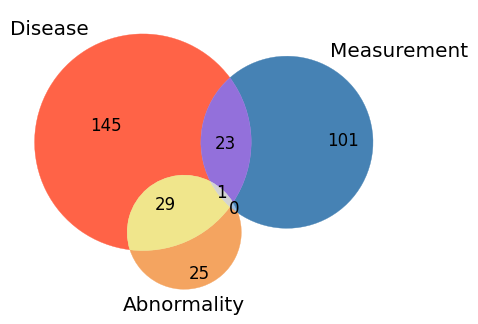

In [111]:
_ = plt.figure(figsize=(5,5))
plt.rcParams.update({'font.size': 12})
v = venn3([set(groups['EFO:0000408']), set(groups['EFO:0001444']), set(groups['HP:0000118'])], 
          set_labels=('Disease', 'Measurement', 'Abnormality'))
v.get_patch_by_id('100').set_color('tomato')
v.get_patch_by_id('010').set_color('steelblue')
v.get_patch_by_id('110').set_color('mediumpurple')
v.get_patch_by_id('111').set_color('lightgrey')
v.get_patch_by_id('001').set_color('sandybrown')
v.get_patch_by_id('101').set_color('khaki')
for patch in ['100', '010','110', '111', '001', '101']:
    v.get_patch_by_id(patch).set_alpha(1)
#plt.title('Trait Overlap (No additional curation)')
plt.savefig(os.path.join(figdir, 'trait_classifications_venn3_abnorm.png'), dpi=400, bbox_inches='tight')

In [236]:
print(groups['BFO:0000019'])

['EFO_0007490', 'EFO_0005089', 'EFO_0008561', 'EFO_0004208', 'HP_0001537', 'HP_0000545', 'EFO_0003762', 'EFO_0009819', 'EFO_0005761', 'EFO_0005524', 'OBA:VT0005144', 'HP_0001919', 'EFO_0004825', 'HP_0100790', 'EFO_0003843', 'HP_0001082', 'OBA:2050068', 'HP_0001395', 'EFO_0006803', 'OBA:2050320', 'EFO_1001866', 'HP_0000540', 'EFO_0004269', 'EFO_0000712', 'HP_0003418', 'HP_0002321', 'EFO_0000685', 'HP_0000964', 'EFO_0006812', 'EFO_0000275', 'EFO_0005676', 'EFO_0000537', 'EFO_1001870', 'EFO_0000095', 'HP_0000360', 'HP_0001634', 'HP_0000023', 'HP_0000483', 'EFO_0006510', 'EFO_0006792', 'EFO_0004207', 'EFO_0000668', 'MONDO_0005301', 'EFO_0003913', 'MONDO_0001627', 'EFO_1000860', 'HP_0000132', 'EFO_1000652', 'EFO_0000699', 'EFO_0001060', 'MONDO_0005277', 'MONDO_0005147', 'HP_0025246', 'OBA:VT0000217', 'EFO_0006927', 'EFO_0003778', 'MONDO_0007915', 'HP_0000486', 'EFO_0000341', 'HP_0002619', 'EFO_0000464', 'OBA:VT0000188', 'MONDO_0004975', 'HP_0012115', 'EFO_0002609', 'EFO_0005763', 'HP_000214

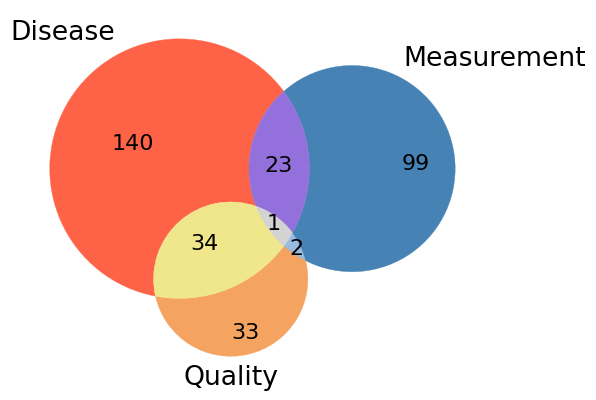

In [112]:
_ = plt.figure(figsize=(6,6))
plt.rcParams.update({'font.size': 16})
v = venn3([set(groups['EFO:0000408']), set(groups['EFO:0001444']), set(groups['BFO:0000019'])], 
          set_labels=('Disease', 'Measurement', 'Quality'))
v.get_patch_by_id('100').set_color('tomato')
v.get_patch_by_id('010').set_color('steelblue')
v.get_patch_by_id('110').set_color('mediumpurple')
v.get_patch_by_id('111').set_color('lightgrey')
v.get_patch_by_id('001').set_color('sandybrown')
v.get_patch_by_id('101').set_color('khaki')
for patch in ['100', '010','110', '111', '001', '101']:
    v.get_patch_by_id(patch).set_alpha(1)
#plt.title('Trait Overlap (No additional curation)')
plt.savefig(os.path.join(figdir, 'trait_classifications_venn3_quality.png'), dpi=400, bbox_inches='tight')
plt.savefig(os.path.join(figdir, 'trait_classifications_venn3_quality.svg'), dpi=400, bbox_inches='tight')

In [54]:
overlap_counts = pd.DataFrame({'TRAIT_CODE':list(overlap_traits), 'Min Genes':3})
overlap_counts.index= overlap_counts['TRAIT_CODE']

In [55]:
all_counts = parent_counts_min_genes(overlap_counts, efo, thresholds=[3])

### Disease subtypes

In [56]:
disease_cats = [x for x in efo.predecessors('EFO:0000408')]
disease_counts = {x:all_counts.loc[x, (3)] for x in disease_cats if x in all_counts.index}
disease_counts = {efo.nodes[x]['name']:disease_counts[x] for x in disease_counts}

In [57]:
def plot_subcategories(parent, efo, all_counts, th=3, display_min=10, **kwargs):
    disease_cats = [x for x in efo.predecessors(parent)]
    disease_counts = {x:all_counts.loc[x, (th)] for x in disease_cats if x in all_counts.index}
    disease_counts = {efo.nodes[x]['name']:disease_counts[x] for x in disease_counts}
    plot_df = pd.DataFrame({'Trait Count': disease_counts}).sort_values(by='Trait Count', ascending=False).reset_index()
    sns.barplot(plot_df[plot_df['Trait Count'] >= display_min], y='index', x='Trait Count', **kwargs)
    plt.ylabel('')
    plt.xlim(0,48 )

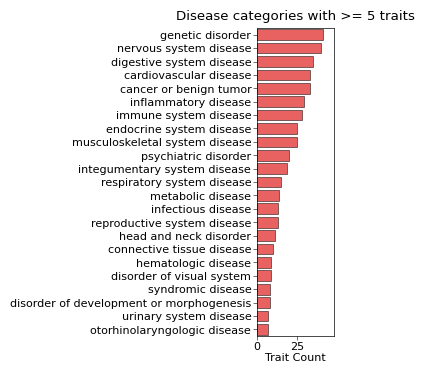

In [58]:
_ = plt.figure(figsize=(1, 4))
plt.rcParams.update({'font.size': 8})
plot_subcategories('EFO:0000408', efo, all_counts, color='red', display_min=5, alpha=0.7, edgecolor='black', linewidth=0.5)
plt.title('Disease categories with >= 5 traits')
plt.savefig(os.path.join(figdir, 'disease_class_bar.png'), dpi=400, bbox_inches='tight')

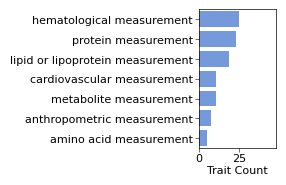

In [59]:
_ = plt.figure(figsize=(1, 1.8))
plot_subcategories('EFO:0001444', efo, all_counts, color='cornflowerblue', display_min=5)
plt.savefig(os.path.join(figdir, 'measurement_class_bar.png'), dpi=400, bbox_inches='tight')

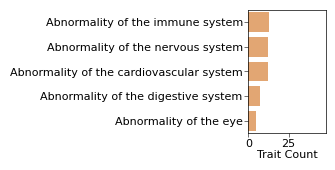

In [60]:
_ = plt.figure(figsize=(1, 1.6))
plot_subcategories('HP:0000118', efo, all_counts, color='sandybrown', display_min=5)
plt.savefig(os.path.join(figdir, 'abnorm_class_bar.png'), dpi=400, bbox_inches='tight')

## Studies per trait

Conclusion:
* GWAS tends to have more studies per trait
* RV tends to have more traits per study
* Both have a majority with single trait-study pairs. 

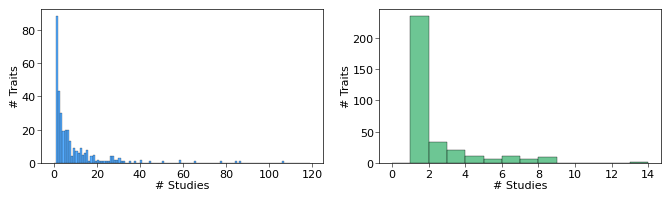

In [61]:
_, [ax1,ax2] = plt.subplots(nrows=1, ncols=2, figsize=(8,2))
sns.histplot(final_cv_gda.groupby('TRAIT_CODE').StudyTrait.nunique(), bins=[i for i in range(120)], 
             color='dodgerblue', ax=ax1)
ax1.set_ylabel('# Traits')
ax1.set_xlabel('# Studies')

sns.histplot(final_rv_gda.groupby('TRAIT_CODE').StudyTrait.nunique(), bins = [i for i in range(15)], 
             color='mediumseagreen', ax=ax2)
ax2.set_ylabel('# Traits')
ax2.set_xlabel('# Studies')
plt.savefig(os.path.join(figdir, 'studies_per_trait.png'), dpi=400, bbox_inches='tight')

#### Traits per study

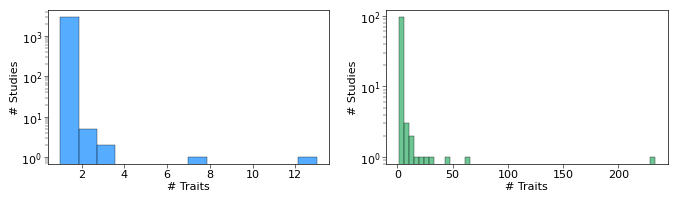

In [63]:
_, [ax1,ax2] = plt.subplots(nrows=1, ncols=2, figsize=(8,2))
sns.histplot(final_cv_gda.groupby('STUDY ACCESSION').TRAIT_CODE.nunique(),bins=14,
             color='dodgerblue', ax=ax1)
ax1.set_xlabel('# Traits')
ax1.set_ylabel('# Studies')
ax1.set_yscale('log')
sns.histplot(final_rv_gda.groupby('PMID').TRAIT_CODE.nunique(), color='mediumseagreen', bins=50, ax=ax2)
ax2.set_xlabel('# Traits')
ax2.set_ylabel('# Studies')
ax2.set_yscale('log')
plt.savefig(os.path.join(figdir, 'traits_per_study.png'), dpi=400, bbox_inches='tight')

## Input sizes

In [5]:
import re
def map_trait_code(code):
    efo = next((match.group() for match in re.finditer(r'EFO_\d+', code)), None)
    if efo is not None:
        return efo
    mondo = next((match.group() for match in re.finditer(r'MONDO_\d+', code)), None)
    if mondo is not None:
        return mondo
    hp = next((match.group() for match in re.finditer(r'HP_\d+', code)), None)
    if hp is not None:
        return hp
    go = next((match.group() for match in re.finditer(r'GO_\d+', code)), None)
    if go is not None:
        return go
    return None

In [6]:
###
over_df = pd.read_csv('/cellar/users/snwright/Data/RareCommon/outputs/overlap/rvc_overlap_results_Jan_2025_v2.txt', sep='\t',
                     header=None, names=['trait_pair', 'param_set', 'n_common', 'n_rare', 'n_overlap', 'background', 'pval'])

over_df['EFO'] = over_df.trait_pair.apply(lambda x: map_trait_code(x))
over_df['StudyC'] = over_df.trait_pair.apply(lambda x: next((match.group() for match in re.finditer(r'GCST\d+', x)), None))
over_df['StudyR'] = over_df.trait_pair.apply(lambda x: x.split('_')[0])
over_df['Expected'] = over_df.n_rare * over_df.n_common / 9000
over_df['logp'] = -1 * np.log10(over_df['pval'] + 1e-250)
over_df.shape

(1880, 12)

In [10]:
over_df[over_df.EFO=='EFO_0004611'].sort_values('StudyR')

,trait_pair,param_set,n_common,n_rare,n_overlap,background,pval,EFO,StudyC,StudyR,Expected,logp
288,30140000.0_EFO_0004611_GCST90018961_EFO_0004611,defaults,107,4,3,20000,7.743238e-10,EFO_0004611,GCST90018961,30140000.0,0.047556,9.111077
289,30140000.0_EFO_0004611_GCST90025954_EFO_0004611,defaults,6,4,3,20000,2.250675e-15,EFO_0004611,GCST90025954,30140000.0,0.002667,14.647687
290,30140000.0_EFO_0004611_GCST90239655_EFO_0004611,defaults,274,4,2,20000,1.007118e-05,EFO_0004611,GCST90239655,30140000.0,0.121778,4.996920
291,30140000.0_EFO_0004611_GCST90278638_EFO_0004611,defaults,32,4,2,20000,1.486605e-08,EFO_0004611,GCST90278638,30140000.0,0.014222,7.827805
292,30140000.0_EFO_0004611_GCST90302098_EFO_0004611,defaults,36,4,2,20000,2.139670e-08,EFO_0004611,GCST90302098,30140000.0,0.016000,7.669653
373,31367044.0_EFO_0004611_GCST90018961_EFO_0004611,defaults,107,8,3,20000,5.331491e-08,EFO_0004611,GCST90018961,31367044.0,0.095111,7.273151
374,31367044.0_EFO_0004611_GCST90025954_EFO_0004611,defaults,6,8,3,20000,1.574968e-13,EFO_0004611,GCST90025954,31367044.0,0.005333,12.802728
375,31367044.0_EFO_0004611_GCST90239655_EFO_0004611,defaults,274,8,3,20000,2.310490e-06,EFO_0004611,GCST90239655,31367044.0,0.243556,5.636296
376,31367044.0_EFO_0004611_GCST90278638_EFO_0004611,defaults,32,8,2,20000,2.072207e-07,EFO_0004611,GCST90278638,31367044.0,0.028444,6.683567
377,31367044.0_EFO_0004611_GCST90302098_EFO_0004611,defaults,36,8,3,20000,6.155259e-10,EFO_0004611,GCST90302098,31367044.0,0.032000,9.210754


Common max 774
Rare max 421


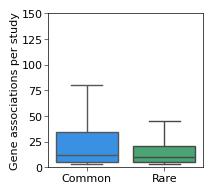

In [66]:
_ = plt.figure(figsize=(2,2))
sns.boxplot(y=over_df.drop_duplicates(subset=['EFO', 'StudyC']).n_common, x=1, fliersize=0, color='dodgerblue')
sns.boxplot(y=over_df.drop_duplicates(subset=['EFO', 'StudyC']).n_rare,x=2, fliersize=0, color='mediumseagreen')
plt.ylim(0, 150)
plt.ylabel('Gene associations per study')
_ = plt.xticks([0,1], ['Common', 'Rare'])
print(f'Common max {over_df.drop_duplicates(subset=["EFO", "StudyC"]).n_common.max()}')
print(f'Rare max {over_df.drop_duplicates(subset=["EFO", "StudyC"]).n_rare.max()}')
plt.savefig(os.path.join(figdir, 'study_association_counts.png'), dpi=400, bbox_inches='tight')

In [67]:
over_df.drop_duplicates(subset=['EFO', 'StudyC']).n_common.describe()

count    1035.000000
mean       44.381643
std        90.302480
min         3.000000
25%         5.000000
50%        12.000000
75%        35.000000
max       774.000000
Name: n_common, dtype: float64

## Input overlap

Select the pair with the greatest overlap in terms of number of genes between RC per trait    
Fixed issue with trait_code not accepting MONDO, HP etc.

In [75]:
r_traitlist = pd.read_csv(os.path.join(datadir, 'inputs/Jan_2025', 'rare.traitlist2'), header=None)[0].values
c_traitlist = pd.read_csv(os.path.join(datadir, 'inputs/Jan_2025', 'common.traitlist2'), header=None)[0].values
pairs = [r_traitlist[i]+'_'+c_traitlist[i] for i in range(len(r_traitlist))]

In [74]:
over_df.head()

,trait_pair,param_set,n_common,n_rare,n_overlap,background,pval,EFO,StudyC,StudyR,Expected,logp
0,19847924.0_EFO_0001645_GCST005195_EFO_0001645,defaults,95,6,0,20000,0.028167,EFO_0001645,GCST005195,19847924.0,0.063333,1.550257
1,19847924.0_EFO_0001645_GCST008370_EFO_0001645,defaults,31,6,0,20000,0.009265,EFO_0001645,GCST008370,19847924.0,0.020667,2.033146
2,19847924.0_EFO_0001645_GCST010479_EFO_0001645,defaults,46,6,0,20000,0.013723,EFO_0001645,GCST010479,19847924.0,0.030667,1.862564
3,19847924.0_EFO_0001645_GCST90132315_EFO_0001645,defaults,24,6,0,20000,0.007179,EFO_0001645,GCST90132315,19847924.0,0.016000,2.143916
4,19847924.0_EFO_0001645_GCST90449059_EFO_0001645,defaults,39,6,0,20000,0.011645,EFO_0001645,GCST90449059,19847924.0,0.026000,1.933877


In [76]:
top_over_df = over_df[over_df.trait_pair.isin(pairs)]
top_over_df.shape

(320, 12)

In [77]:
top_over_df['rare_only'] = top_over_df.n_rare - top_over_df.n_overlap
top_over_df['common_only'] = top_over_df.n_common - top_over_df.n_overlap
top_over_df['total'] = top_over_df.rare_only + top_over_df.common_only + top_over_df.n_overlap
top_over_df['overlap+rare'] = top_over_df.n_overlap + top_over_df.rare_only
top_over_df = top_over_df.sort_values(by=['n_overlap', 'total'], ascending=False)

/tmp/ipykernel_2423899/1321152466.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_over_df['rare_only'] = top_over_df.n_rare - top_over_df.n_overlap
/tmp/ipykernel_2423899/1321152466.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_over_df['common_only'] = top_over_df.n_common - top_over_df.n_overlap
/tmp/ipykernel_2423899/1321152466.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the

In [100]:
plot_df=top_over_df[(top_over_df.param_set=='defaults') & ((top_over_df.total > 100) ) & (top_over_df.total < 1000)].melt(id_vars=['trait_pair', 'pval', 'logp'], value_vars=['n_overlap', 'overlap+rare', 'total'])

In [101]:
total_order = top_over_df[top_over_df.param_set=='defaults'].sort_values(by=['n_overlap', 'n_rare', 'n_common'], ascending=[False, False, False]).trait_pair.values

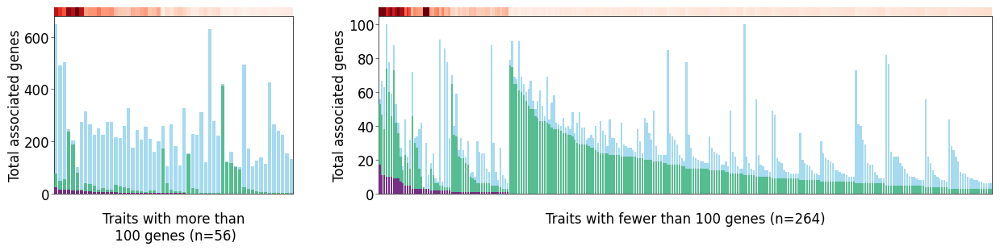

In [102]:
_, [[ax1a, ax2a], [ax1, ax2]] = plt.subplots(2, 2, figsize=(15, 3), sharex=False, gridspec_kw={'height_ratios': [1, 20], 'width_ratios':[82,210], 'hspace': 0})


plt.rcParams.update({'font.size': 12})
order = [x for x in total_order if x in plot_df.trait_pair.values]
n1=len(order)
#plot_df[plot_df.variable=='n_overlap'].sort_values('value', ascending=False).trait_pair
sns.heatmap(np.array(plot_df[plot_df.variable=='total'].set_index('trait_pair').loc[order]['logp']).reshape(-1, 1).T, ax=ax1a, cbar=False, cmap='Reds', yticklabels=False, xticklabels=False,vmax=25, vmin=0)

sns.barplot(plot_df[plot_df.variable=='n_overlap'], x='trait_pair', y='value', color='purple', zorder=10, order=order, 
            saturation=1, ax=ax1, alpha=0.75)
sns.barplot(plot_df[plot_df.variable=='overlap+rare'], x='trait_pair', y='value', color='mediumseagreen', zorder=5, order=order,
            saturation=1,  ax=ax1, alpha=0.75)
sns.barplot(plot_df[plot_df.variable=='total'], x='trait_pair', y='value', color='skyblue', zorder=1, order=order, 
            saturation=1, ax=ax1, alpha=0.75)
ax1.set_xticks([])


plot_df2 =top_over_df[(top_over_df.param_set=='defaults')  & (top_over_df.total <= 100)].melt(id_vars=['trait_pair', 'pval', 'logp'], value_vars=['n_overlap', 'overlap+rare', 'total'])
order = [x for x in total_order if x in plot_df2.trait_pair.values]
#plot_df2[plot_df2.variable=='n_overlap'].sort_values('value', ascending=False).trait_pair

n2=len(order)
sns.heatmap(np.array(plot_df2[plot_df2.variable=='total'].set_index('trait_pair').loc[order]['logp']).reshape(-1, 1).T, 
            ax=ax2a, cbar=False, 
            cmap='Reds', yticklabels=False, xticklabels=False, vmax=25, vmin=0)

sns.barplot(plot_df2[plot_df2.variable=='n_overlap'], x='trait_pair', y='value', color='purple', zorder=10, order=order, ax=ax2, alpha=0.75, saturation=1)
sns.barplot(plot_df2[plot_df2.variable=='overlap+rare'], x='trait_pair', y='value', color='mediumseagreen', zorder=5, order=order, ax=ax2, alpha=0.75, saturation=1)
sns.barplot(plot_df2[plot_df2.variable=='total'], x='trait_pair', y='value', color='skyblue', zorder=1, order=order, ax=ax2, alpha=0.75, saturation=1)
ax2.set_xticks([])
ax1.set_xlabel(f'\nTraits with more than\n 100 genes (n={n1})')
ax2.set_xlabel(f'\nTraits with fewer than 100 genes (n={n2})')
_ = ax1.set_ylabel('Total associated genes')
_ = ax2.set_ylabel('Total associated genes')
plt.savefig(os.path.join(figdir, 'overlap_summary.jpg'), dpi=400, bbox_inches='tight')

### P-values of overlap vs rare/common only

In [81]:
over_df.shape

(1880, 12)

In [82]:
from math import comb
from scipy.stats import mannwhitneyu

def get_p_values(gda_df, study, trait):
    if 'logp' not in gda_df.columns:
        gda_df['logp'] = -1 * np.log10(gda_df['P-value'] + 1e-250)
    use_gda = gda_df[gda_df.StudyTrait==f'{study}{trait}'].sort_values('logp', ascending=False).drop_duplicates('Entrez', keep='first')
    return use_gda.loc[:, ('logp', 'Entrez')].set_index('Entrez')

def compare_pval_dists(studyC, studyR, trait):
    rv_p = get_p_values(rv_gda, studyR, trait)
    cv_p = get_p_values(cv_gda, studyC, trait)
    overlap_genes = rv_p.join(cv_p, lsuffix='r',how='inner').index.values
    r_mo, r_mno, r_stat, r_p = perform_p_val_rank_test(rv_p, overlap_genes)
    c_mo, c_mno, c_stat, c_p = perform_p_val_rank_test(cv_p, overlap_genes)
    return {f'{studyR}_{trait}_{studyC}_{trait}': {'rStat':r_stat, 'cStat':c_stat, 'rP':r_p, 'cP':c_p,
                                                  'rSharedMed':r_mo, 'rOnlyMed': r_mno,
                                                  'cSharedMed': c_mo, 'cOnlyMed': c_mno}}

def compare_global_p_dists(over_df):
    common_only = []
    rare_only = []
    common_shared = []
    rare_shared = []
    for row in tqdm(over_df.iterrows()):
        studyC = row[1]['StudyC']
        studyR = row[1]['StudyR']
        trait = row[1]['EFO']
        rv_p = get_p_values(rv_gda, studyR, trait)
        cv_p = get_p_values(cv_gda, studyC, trait)
        overlap_genes = rv_p.join(cv_p, lsuffix='r',how='inner').index.values
        common_only.append(cv_p[~cv_p.index.isin(overlap_genes)])
        rare_only.append(rv_p[~rv_p.index.isin(overlap_genes)])
        common_shared.append(cv_p[cv_p.index.isin(overlap_genes)])
        rare_shared.append(rv_p[rv_p.index.isin(overlap_genes)])
    common_only = pd.concat(common_only).reset_index().assign(Variant='Common', Group='Only')
    rare_only = pd.concat(rare_only).reset_index().assign(Variant='Rare', Group='Only')
    common_shared = pd.concat(common_shared).reset_index().assign(Variant='Common', Group='Shared')
    rare_shared = pd.concat(rare_shared).reset_index().assign(Variant='Rare', Group='Shared')
    return pd.concat([common_only, rare_only, common_shared, rare_shared]).reset_index()

    
def perform_p_val_rank_test(pvals, overlap_genes):
    median_overlap =  pvals[pvals.index.isin(overlap_genes)].logp.median()
    median_non_overlap = pvals[~pvals.index.isin(overlap_genes)].logp.median()
    if is_sample_size_useful(len(pvals), len(overlap_genes)):
        x = mannwhitneyu(pvals[~pvals.index.isin(overlap_genes)], pvals[pvals.index.isin(overlap_genes)])
        return median_overlap, median_non_overlap, x.statistic[0], x.pvalue[0]
    else:
        return median_overlap, median_non_overlap, np.nan, np.nan

def is_sample_size_useful(n_total, n_overlap):
    if n_overlap == 0:
        return False
    if 2 / comb(n_total, n_overlap) > 0.05:
        return False
    else:
        return True

In [84]:
results = {}
for row in tqdm(top_over_df.iterrows()):
    results = {**results,  **compare_pval_dists(row[1]['StudyC'], row[1]['StudyR'], row[1]['EFO'])}
    

320it [00:09, 35.38it/s]


In [85]:
test_df = pd.DataFrame.from_dict(results, orient='index')

In [86]:
# proportion that could be assessed
len(test_df.dropna())/len(test_df)

0.140625

In [87]:
test_df2 = test_df.dropna()
test_df2.head()

,rStat,cStat,rP,cP,rSharedMed,rOnlyMed,cSharedMed,cOnlyMed
33230300.0_EFO_0005763_GCST90310296_EFO_0005763,319.0,7260.5,0.000439,0.884414,10.521434,8.033389,9.698970,9.698970
33230300.0_EFO_0006336_GCST90449057_EFO_0006336,281.0,2342.0,0.858302,0.008631,7.110698,8.127811,20.698970,10.154902
34226706.0_EFO_0007986_GCST90025970_EFO_0007986,59.5,27.0,0.000003,0.921053,15.065502,7.887345,23.301030,23.698970
33230300.0_EFO_0006335_GCST90449056_EFO_0006335,244.0,2209.0,0.138102,0.009340,8.698731,6.928118,15.522879,10.397940
36809768.0_EFO_0020946_GCST90269691_EFO_0020946,574.0,51.0,0.000069,0.468691,28.815632,10.608506,37.000000,23.698970


<Axes: xlabel='Set', ylabel='P'>

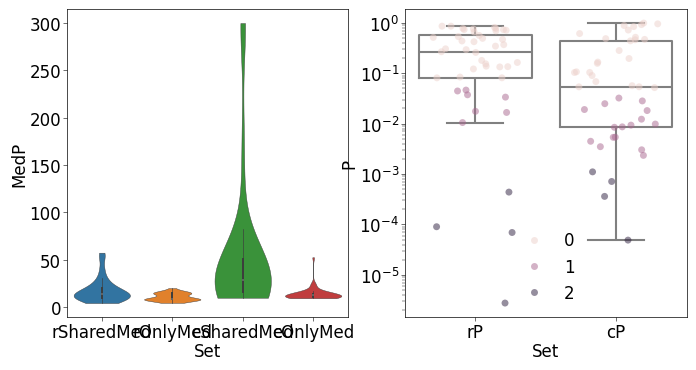

In [88]:
_, [ax1, ax2] = plt.subplots(nrows=1, ncols=2, figsize=(8, 4))
sns.violinplot(test_df2.melt(value_vars=['rSharedMed', 'rOnlyMed', 'cSharedMed', 'cOnlyMed'], var_name='Set', value_name='MedP'),
              x='Set', y='MedP', hue='Set', cut=0, ax=ax1)

plot_df = test_df2.melt(value_vars=['rP', 'cP'], var_name='Set', value_name='P')
plot_df['Sig'] = plot_df.P.apply(lambda x: 0 if x > 0.05 else 1 if x > 0.1/len(plot_df) else 2)
sns.stripplot(plot_df, jitter=0.3,
              x='Set', y='P', hue='Sig', log_scale=True, alpha=0.5, ax=ax2)
sns.boxplot(plot_df, x='Set', y='P', log_scale=True, fliersize=0, fill=False, color='grey', ax=ax2)

In [89]:
results_top = {}
for row in tqdm(top_over_df.iterrows()):
    results_top = {**results_top,  **compare_pval_dists(row[1]['StudyC'], row[1]['StudyR'], row[1]['EFO'])}
test_df_top = pd.DataFrame.from_dict(results_top, orient='index')

320it [00:08, 35.59it/s]


In [90]:
# proportion that could be assessed
len(test_df_top.dropna())/len(test_df_top)

0.140625

In [91]:
test_df_top2 = test_df_top.dropna()
test_df_top2.head()

,rStat,cStat,rP,cP,rSharedMed,rOnlyMed,cSharedMed,cOnlyMed
33230300.0_EFO_0005763_GCST90310296_EFO_0005763,319.0,7260.5,0.000439,0.884414,10.521434,8.033389,9.698970,9.698970
33230300.0_EFO_0006336_GCST90449057_EFO_0006336,281.0,2342.0,0.858302,0.008631,7.110698,8.127811,20.698970,10.154902
34226706.0_EFO_0007986_GCST90025970_EFO_0007986,59.5,27.0,0.000003,0.921053,15.065502,7.887345,23.301030,23.698970
33230300.0_EFO_0006335_GCST90449056_EFO_0006335,244.0,2209.0,0.138102,0.009340,8.698731,6.928118,15.522879,10.397940
36809768.0_EFO_0020946_GCST90269691_EFO_0020946,574.0,51.0,0.000069,0.468691,28.815632,10.608506,37.000000,23.698970


<Axes: xlabel='Set', ylabel='P'>

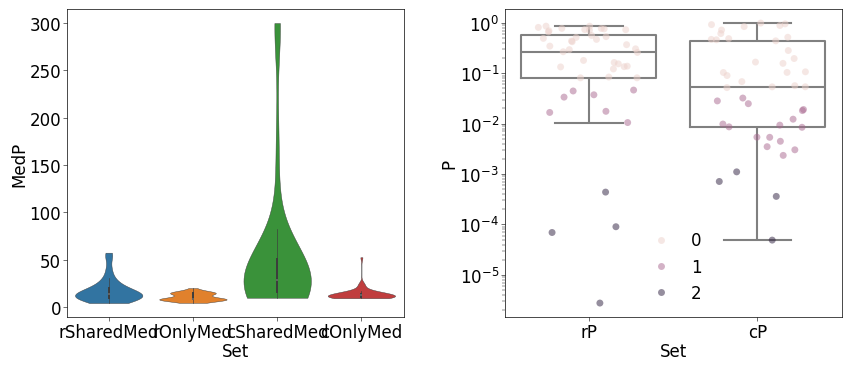

In [92]:
_, [ax1, ax2] = plt.subplots(nrows=1, ncols=2, figsize=(10, 4), gridspec_kw={'wspace':0.3})
sns.violinplot(test_df_top2.melt(value_vars=['rSharedMed', 'rOnlyMed', 'cSharedMed', 'cOnlyMed'], var_name='Set', value_name='MedP'),
              x='Set', y='MedP', hue='Set', cut=0, ax=ax1)

plot_df = test_df_top2.melt(value_vars=['rP', 'cP'], var_name='Set', value_name='P')
plot_df['Sig'] = plot_df.P.apply(lambda x: 0 if x > 0.05 else 1 if x > 0.1/len(plot_df) else 2)
sns.stripplot(plot_df, jitter=0.3,
              x='Set', y='P', hue='Sig', log_scale=True, alpha=0.5, ax=ax2)
sns.boxplot(plot_df, x='Set', y='P', log_scale=True, fliersize=0, fill=False, color='grey', ax=ax2)

In [93]:
x = compare_global_p_dists(top_over_df)

320it [00:09, 34.04it/s]


<Axes: xlabel='Variant', ylabel='count'>

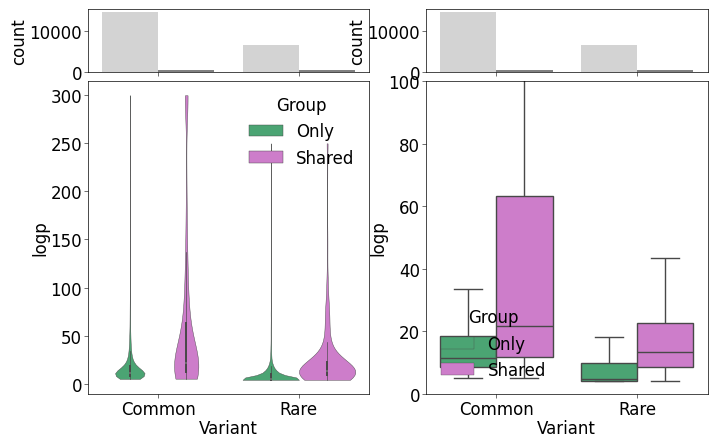

In [94]:
_, [[ax3,ax4], [ax1, ax2]] = plt.subplots(nrows=2, ncols=2, figsize=(8,5), sharex=True,
                                         gridspec_kw={'height_ratios':[1,5], 'hspace':0.05})
sns.violinplot(x, x='Variant', y='logp', hue='Group', cut=0, ax=ax1, palette=['mediumseagreen', 'orchid'])
sns.boxplot(x, x='Variant', y='logp', hue='Group', fliersize=0, ax=ax2, palette=['mediumseagreen', 'orchid'])
ax2.set_ylim(0,100)

sns.barplot(x.groupby('Variant').Group.value_counts().reset_index(), x='Variant', y='count', hue='Group', ax=ax3, 
           palette=['lightgrey', 'grey'], legend=False)
sns.barplot(x.groupby('Variant').Group.value_counts().reset_index(), x='Variant', y='count', hue='Group', ax=ax4,
           palette=['lightgrey', 'grey'], legend=False)

In [97]:
common = mannwhitneyu(x[(x.Variant=='Common') & (x.Group=='Only')].logp.values, x[(x.Variant=='Common') & (x.Group=='Shared')].logp.values)
common

MannwhitneyuResult(statistic=1723521.0, pvalue=2.5274769738986697e-49)

In [98]:
rare = mannwhitneyu(x[(x.Variant=='Rare') & (x.Group=='Only')].logp.values, x[(x.Variant=='Rare') & (x.Group=='Shared')].logp.values)
rare

MannwhitneyuResult(statistic=494577.5, pvalue=1.9521007663815244e-102)

### Look at reproducibility of shared vs common/rare only genes

## Example trait venn diagrams

In [123]:
traits = ['EFO_0004570', 'EFO_0009961', 'EFO_0004630',  'EFO_0000612',  'EFO_0000400', 'EFO_0000756', 'EFO_0000684']

In [126]:
top_over_df[top_over_df.EFO=='EFO_0000400']

,trait_pair,param_set,n_common,n_rare,n_overlap,background,pval,EFO,StudyC,StudyR,Expected,logp,rare_only,common_only,total,overlap+rare
655,34375979.0_EFO_0000400_GCST90246054_EFO_0000400,defaults,5,102,0,20000,0.025244,EFO_0000400,GCST90246054,34375979.0,0.056667,1.597847,102,5,107,102


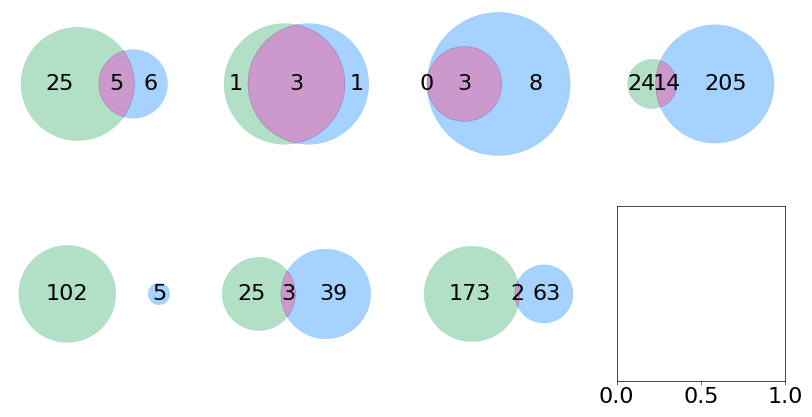

In [223]:
plt.rcParams.update({'font.size': 16})
_, [[ax1,ax2,ax3,ax4], [ax5, ax6, ax7, ax8]] = plt.subplots(2, 4, figsize=(10, 5), sharex=False, sharey=True)
for i in range(len(traits)):
    trait_info = top_over_df[(top_over_df.EFO==traits[i]) & (top_over_df.param_set=='defaults')]
    subsets = trait_info.loc[:, ('rare_only', 'common_only', 'n_overlap')].values[0]
    v = venn2(subsets=subsets, set_labels=('', ''), ax=eval(f'ax{i+1}'))
    #eval(f'ax{i+1}').set_title(traits[i])
    try:
        v.get_patch_by_id('10').set_color('mediumseagreen')
        v.get_patch_by_id('01').set_color('dodgerblue')
        v.get_patch_by_id('11').set_color('purple')
    except:
        pass
plt.savefig(os.path.join(figdir, 'example_vens.jpg'), dpi=400, bbox_inches='tight')